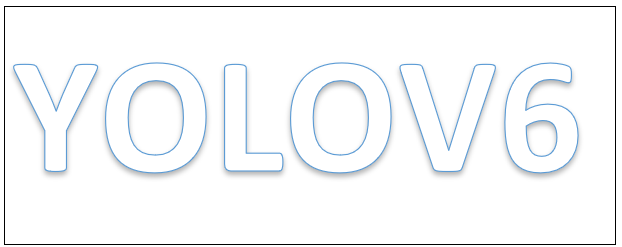

# **CONNECTION AND CONFIGURATION**

In [1]:
# Check if NVIDIA GPU is enabled
!nvidia-smi

Wed Feb  8 11:58:38 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.47.03    Driver Version: 510.47.03    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   63C    P0    25W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [2]:
import torch
import os
from IPython.display import Image, clear_output  # to display images
import glob
import  shutil
from sklearn.model_selection import train_test_split

In [3]:
from google.colab import drive
drive.mount('/content/gdrive')
!ln -s /content/gdrive/My\ Drive/ /mydrive

Mounted at /content/gdrive


## Install Dependencies and requirements



In [4]:
# Download MT-YOLOv6 repository and install requirements
!git clone https://github.com/meituan/YOLOv6
%cd YOLOv6
!pip install -r requirements.txt

Cloning into 'YOLOv6'...
remote: Enumerating objects: 2793, done.
remote: Counting objects: 100% (38/38), done.
remote: Compressing objects: 100% (34/34), done.
remote: Total 2793 (delta 11), reused 12 (delta 4), pack-reused 2755
Receiving objects: 100% (2793/2793), 37.00 MiB | 11.75 MiB/s, done.
Resolving deltas: 100% (1573/1573), done.
/content/YOLOv6
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.3/17.3 MB 60.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.5/13.5 MB 72.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 73.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 34.5/34.5 MB 15.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.1/13.1 MB 76.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 239.0/239.0 KB 27.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 84.5/84.5 KB 11

#**DATASET**

We need our dataset in the YOLOv6 format, which requires YOLO TXT annotations, organized directories, and a specific `.yaml` config file.

Save the dataset into mydrive with the folowing format


```
Dataset directory format

content/yolov6/data____images___train
                  |      |______val
                  |      |______test
                  |
                  |____labels___train
                         |______val
                         |______test

```

In [5]:
image_path = '/content/gdrive/MyDrive/yolov6'

In [7]:
!mkdir data
!unzip {image_path}/dataset.zip -d data

mkdir: cannot create directory ‘data’: File exists
Archive:  /content/gdrive/MyDrive/yolov6/dataset.zip
  inflating: data/dataset/m13-m14-0000.jpg  
  inflating: data/dataset/m13-m14-0000.txt  
  inflating: data/dataset/m13-m14-0022.jpg  
  inflating: data/dataset/m13-m14-0022.txt  
  inflating: data/dataset/m13-m14-0025.jpg  
  inflating: data/dataset/m13-m14-0025.txt  
  inflating: data/dataset/m13-m14-0028.jpg  
  inflating: data/dataset/m13-m14-0028.txt  
  inflating: data/dataset/m13-m14-0031.jpg  
  inflating: data/dataset/m13-m14-0031.txt  
  inflating: data/dataset/m13-m14-0034.jpg  
  inflating: data/dataset/m13-m14-0034.txt  
  inflating: data/dataset/m13-m14-0037.jpg  
  inflating: data/dataset/m13-m14-0037.txt  
  inflating: data/dataset/m13-m14-0040.jpg  
  inflating: data/dataset/m13-m14-0040.txt  
  inflating: data/dataset/m13-m14-0043.jpg  
  inflating: data/dataset/m13-m14-0043.txt  
  inflating: data/dataset/m13-m14-0046.jpg  
  inflating: data/dataset/m13-m14-0046.tx

In [8]:
image_path = os.getcwd()

##Split into train, tests and validation

In [9]:
images_list = glob.glob(f"{image_path}/data/dataset/*.jpg")
label_list = glob.glob(f"{image_path}/data/dataset/*.txt")

In [10]:
images_list.sort()
label_list.sort()

# Split the dataset into train-valid-test splits 
train_images, val_images, train_annotations, val_annotations = train_test_split(images_list, label_list, test_size = 0.2, random_state = 1)
val_images, test_images, val_annotations, test_annotations = train_test_split(val_images, val_annotations, test_size = 0.5, random_state = 1)

In [11]:
%cd {image_path}/data

!mkdir images   labels
!mkdir images/train  images/test images/val  labels/train   labels/test  labels/val

/content/YOLOv6/data
mkdir: cannot create directory ‘images’: File exists


In [12]:
%cd /content/YOLOv6/data
#Utility function to move images 
def move_files_to_folder(list_of_files, destination_folder):
    for f in list_of_files:
        try:
            shutil.move(f, destination_folder)
        except:
            print(f)
            assert False

# Move the splits into their folders

move_files_to_folder(train_images, './images/train/')
move_files_to_folder(val_images, './images/val/')
move_files_to_folder(test_images, './images/test/')
move_files_to_folder(train_annotations, './labels/train/')
move_files_to_folder(val_annotations, './labels/val/')
move_files_to_folder(test_annotations, './labels/test/')

/content/YOLOv6/data


In [13]:
print("Number of training images:", len(os.listdir(f'{image_path}/data/images/train')))
print("Number of test images:", len(os.listdir(f'{image_path}/data/images/test')))
print("Number of validation images:", len(os.listdir(f'{image_path}/data/images/val')))

Number of training images: 254
Number of test images: 32
Number of validation images: 32


###*Create .yalm file*

Create file data.yalm in the directory .\yolov6\dataset\, containing (where classes = number of objects): 

* train  = content/yolov6/data/images/train
* test = content/yolov6/data/images/test
* valid  = content/yolov6/data/images/val
* classes = 1
* names = ['object']

In [14]:
%cd /content/YOLOv6/data

/content/YOLOv6/data


In [15]:
!echo -e 'train : /content/YOLOv6/data/images/train\ntest: /content/YOLOv6/data/images/test\nval: /content/YOLOv6/data/images/val\n#Classes\nnc: 1\nnames: ["maiz14"]'> /content/YOLOv6/data/data.yaml

In [16]:
path_to_dataset = '/content/gdrive/MyDrive/yolov6/data'


#**PRETRAINED WEIGHTS**

In [17]:
%cd /content/YOLOv6
!mkdir /content/YOLOv6/weights
%cd /content/YOLOv6/weights

/content/YOLOv6
/content/YOLOv6/weights


In [19]:
!gdown https://github.com/meituan/YOLOv6/releases/download/0.3.0/yolov6s.pt

Downloading...
From: https://github.com/meituan/YOLOv6/releases/download/0.3.0/yolov6s.pt
To: /content/YOLOv6/weights/yolov6s.pt
100% 40.8M/40.8M [00:00<00:00, 131MB/s]


#**TRAIN**

<font color='RED'>*RUN THE METRIC CELL TO FOLLOW TRAINING*</font>




### Custom Configuration

YOLOv6 also supports creating a custom configuration file for training YOLOv6-n, YOLOv6-tiny, and YOLOv6s.

 You can also start training with a configuration that uses finetuning (e.g. `yolov6s_finetune.py` or starting from scratch (`yolov6s.py`). Finetuning will train faster though may not be as effective on unique datasets.

### Default Arguments
- --data-path, default='./data/coco.yaml', type=str, help='path of dataset')
- --conf-file, default='./configs/yolov6s.py', type=str, help='experiments description file')
- --img-size, type=int, default=640, help='train, val image size (pixels)')
- --batch-size, default=32, type=int, help='total batch size for all GPUs')
- --epochs, default=400, type=int, help='number of total epochs to run')
- --workers, default=8, type=int, help='number of data loading workers (default: 8)')
- --device, default='0', type=str, help='cuda device, i.e. 0 or 0,1,2,3 or cpu')
- --eval-interval, type=int, default=20, help='evaluate at every interval epochs')
- --eval-final-only, action='store_true', help='only evaluate at the final epoch')
- --heavy-eval-range, default=50,help='evaluating every epoch for last such epochs (can be jointly used with --eval-interval)')
- --check-images, action='store_true', help='check images when initializing datasets')
- --check-labels, action='store_true', help='check label files when initializing datasets')
- --output-dir, default='./runs/train', type=str, help='path to save outputs')
- --name, default='exp', type=str, help='experiment name, saved to output_dir/name')
- --dist_url, type=str, default="default url: tcp://127.0.0.1:8888")
- --gpu_count, type=int, default=0)
- --local_rank, type=int, default=-1, help='DDP parameter')
- --resume, type=str, default=None, help='resume the corresponding ckpt')


In [21]:
%cd /content/YOLOv6

/content/YOLOv6


In [24]:
# run this cell to begin training  
!python tools/train.py --batch 8 --conf configs/yolov6s_finetune.py --epochs 100 --img-size 640 --data data/data.yaml --device 0 --output-dir '/content/gdrive/MyDrive/yolov6/runs/train' 

Using 1 GPU for training... 
training args are: Namespace(batch_size=8, bs_per_gpu=32, calib=False, check_images=False, check_labels=False, conf_file='configs/yolov6s_finetune.py', data_path='data/data.yaml', device='0', dist_url='env://', distill=False, distill_feat=False, epochs=100, eval_final_only=False, eval_interval=20, fuse_ab=False, gpu_count=0, heavy_eval_range=50, img_size=640, local_rank=-1, name='exp', output_dir='/content/gdrive/MyDrive/yolov6/runs/train', quant=False, rank=-1, resume=False, save_ckpt_on_last_n_epoch=-1, save_dir='/content/gdrive/MyDrive/yolov6/runs/train/exp1', stop_aug_last_n_epoch=15, teacher_model_path=None, temperature=20, workers=8, world_size=1, write_trainbatch_tb=False)

Train: Final numbers of valid images: 254/ labels: 254. 
0.0s for dataset initialization.
Convert to COCO format
100% 32/32 [00:00<00:00, 33454.07it/s]
Convert to COCO format finished. Resutls saved in /content/YOLOv6/data/annotations/instances_val.json
Val: Final numbers of valid

#**METRICS**

In [26]:
# Tensorboard  (optional)
%load_ext tensorboard
%tensorboard --logdir /content/gdrive/MyDrive/yolov6/runs/train
%reload_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 37264), started 0:00:03 ago. (Use '!kill 37264' to kill it.)

<IPython.core.display.Javascript object>

Validation mAP@0.5

val_mAP@0.5 (1).svg

#**DETECTION**


We can evaluate the performance of our custom training using the provided evalution script.

Note we can adjust the below custom arguments.

- --data, type=str, default='./data/coco.yaml', help='dataset.yaml path')
- -weights, type=str, default='./weights/yolov6s.pt', help='model.pt path(s)')
- --batch-size, type=int, default=32, help='batch size')
- --img-size, type=int, default=640, help='inference size (pixels)')
- --conf-thres, type=float, default=0.001, help='confidence threshold')
- --iou-thres, type=float, default=0.65, help='NMS IoU threshold')
- --task, default='val', help='val, or speed')
- --device, default='0', help='cuda device, i.e. 0 or 0,1,2,3 or cpu')
- --half, default=False, action='store_true', help='whether to use fp16 infer')
- --save_dir, type=str, default='runs/val/', help='evaluation save dir')
- -name, type=str, default='exp', help='save evaluation results to save_dir/name')

Similar to training, we will pass 416x416 images for evaluation as an example.

In [27]:
%cd /content/YOLOv6

/content/YOLOv6


In [29]:
# Run evaluation
!python tools/eval.py --data data/data.yaml --img-size 640 --weights /content/gdrive/MyDrive/yolov6/runs/train/exp1/weights/best_ckpt.pt --device 0 --save_dir '/content/gdrive/MyDrive/yolov6/runs/val'

Namespace(batch_size=32, conf_thres=0.03, config_file='', data='data/data.yaml', device='0', do_coco_metric=True, do_pr_metric=False, eval_config_file='./configs/experiment/eval_640_repro.py', force_no_pad=False, half=False, img_size=640, iou_thres=0.65, letterbox_return_int=False, name='exp', not_infer_on_rect=False, plot_confusion_matrix=False, plot_curve=True, reproduce_640_eval=False, save_dir='/content/gdrive/MyDrive/yolov6/runs/val', scale_exact=False, task='val', test_load_size=640, verbose=False, weights='/content/gdrive/MyDrive/yolov6/runs/train/exp1/weights/best_ckpt.pt')
Loading checkpoint from /content/gdrive/MyDrive/yolov6/runs/train/exp1/weights/best_ckpt.pt

Fusing model...
/usr/local/lib/python3.8/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3190.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-

## Inference

We can run inference on images of our custom trained model using the provided inference utility.

There are a number of arguments we can adjust:

- --weights, type=str, default='weights/yolov6s.pt', help='model path(s) for inference.')
- --source, type=str, default='data/images', help='the source path, e.g. image-file/dir.')
- --yaml, type=str, default='data/coco.yaml', help='data yaml file.')
- --img-size, type=int, default=640, help='the image-size(h,w) in inference size.')
- --conf-thres, type=float, default=0.25, help='confidence threshold for inference.')
- --iou-thres, type=float, default=0.45, help='NMS IoU threshold for inference.')
- --max-det, type=int, default=1000, help='maximal inferences per image.')
- --device, default='0', help='device to run our model i.e. 0 or 0,1,2,3 or cpu.')
- --save-txt, action='store_true', help='save results to *.txt.')
- --save-img, action='store_false', help='save visuallized inference results.')
- --classes, nargs='+', type=int, help='filter by classes, e.g. --classes 0, or --classes 0 2 3.')
- --agnostic-nms, action='store_true', help='class-agnostic NMS.')
- --project, default='runs/inference', help='save inference results to project/name.')
- -name, default='exp', help='save inference results to project/name.')
- --hide-labels, default=False, action='store_true', help='hide labels.')
- --hide-conf, default=False, action='store_true', help='hide confidences.')
- --half, action='store_true', help='whether to use FP16 half-precision inference.')

We need to pass our custom `.yaml` file so that our label names are correct. We will also pass our `/test` directory to run inference on all images in our test split. In addition, similar to training, we will pass 416x416 images for inference as an example.


In [30]:
# infer on all images in our /test directory
%cd /content/YOLOv6
!python tools/infer.py --yaml data/data.yaml --weights /content/gdrive/MyDrive/yolov6/runs/train/exp1/weights/best_ckpt.pt --img 640 640 --source /content/YOLOv6/data/images/test/ --device 0 --project /content/gdrive/MyDrive/yolov6/data/inference 

/content/YOLOv6
Namespace(agnostic_nms=False, classes=None, conf_thres=0.4, device='0', half=False, hide_conf=False, hide_labels=False, img_size=[640, 640], iou_thres=0.45, max_det=1000, name='exp', not_save_img=False, project='/content/gdrive/MyDrive/yolov6/data/inference', save_dir=None, save_txt=False, source='/content/YOLOv6/data/images/test/', view_img=False, webcam=False, webcam_addr='0', weights='/content/gdrive/MyDrive/yolov6/runs/train/exp1/weights/best_ckpt.pt', yaml='data/data.yaml')
Loading checkpoint from /content/gdrive/MyDrive/yolov6/runs/train/exp1/weights/best_ckpt.pt

Fusing model...
Switch model to deploy modality.
/usr/local/lib/python3.8/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3190.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
100% 32/32 [00:06<00:00,  4.67it/s]
Results sav

In [31]:
%cd /content/gdrive/MyDrive/yolov6/data

/content/gdrive/MyDrive/yolov6/data


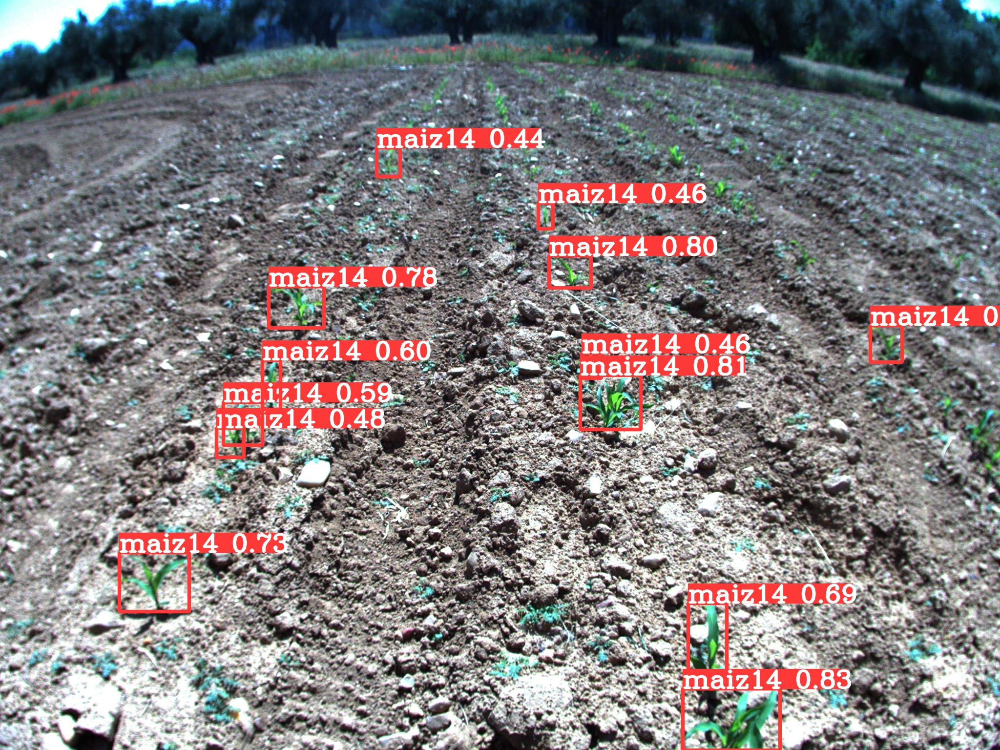

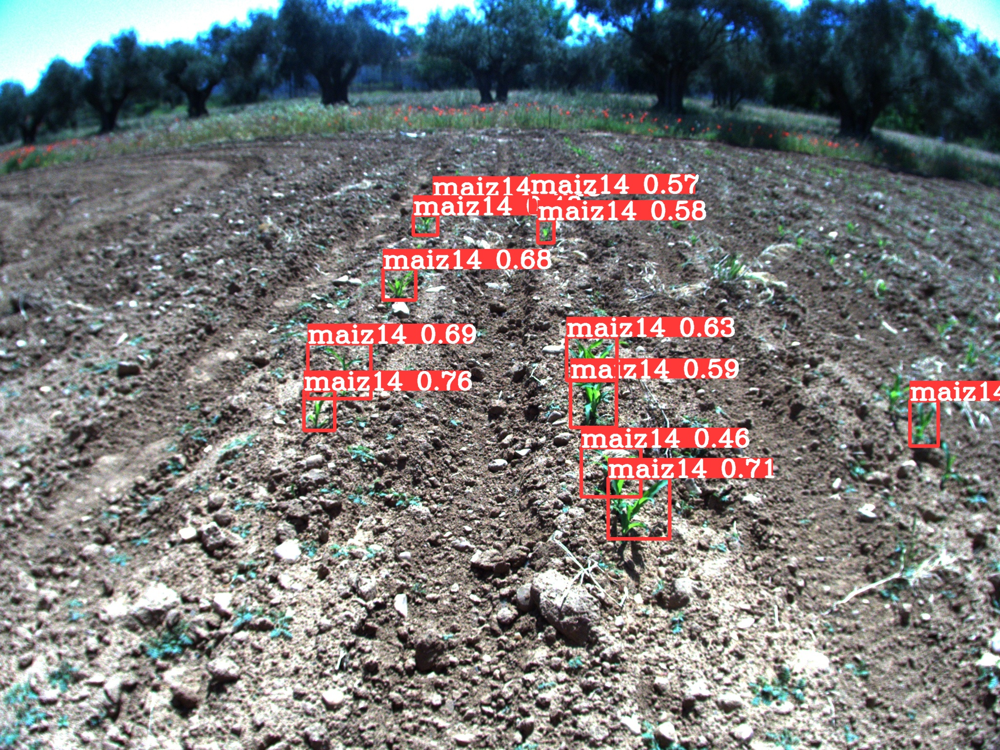

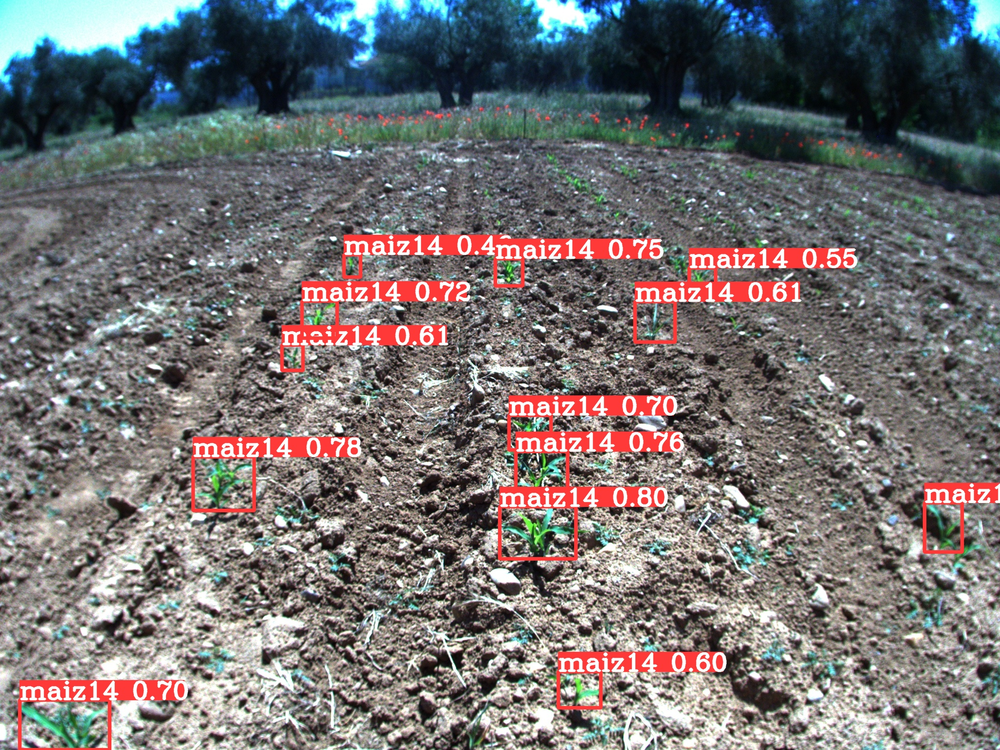

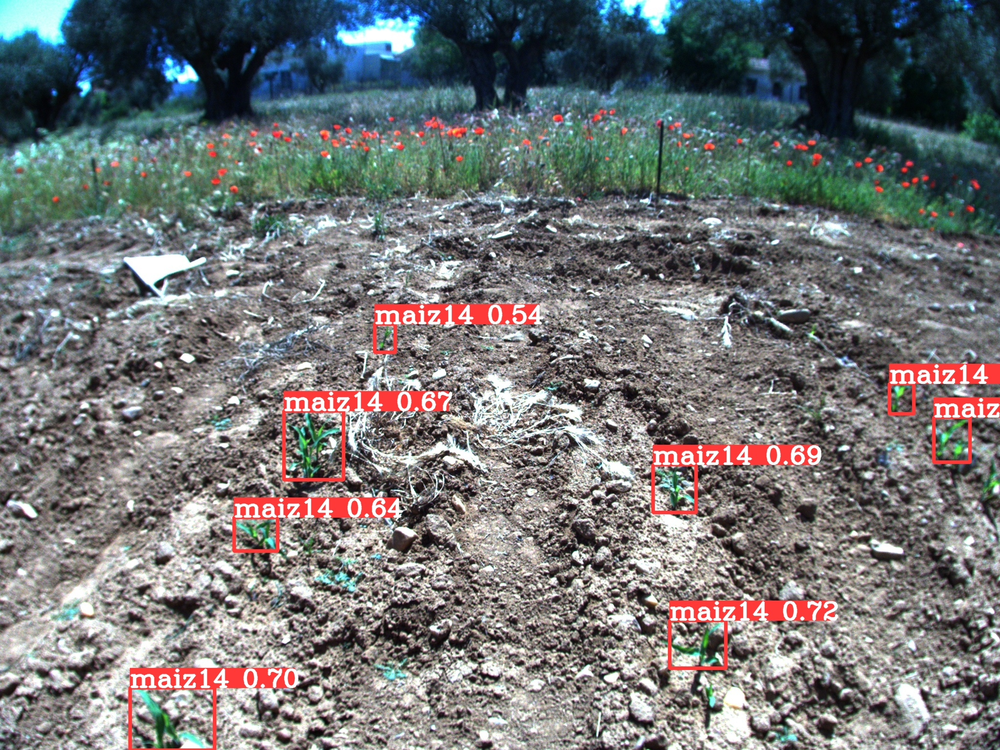

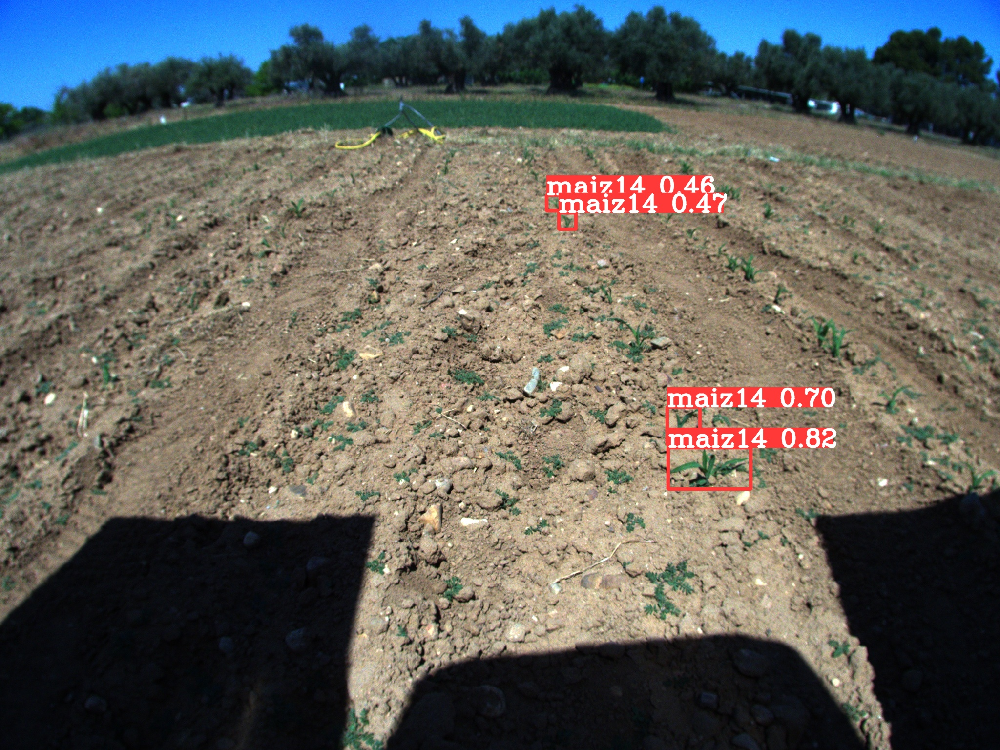

In [32]:
# display test inference result images
import glob
from IPython.display import Image, display

i = 5
limit = i + 5 # max images to print
for imageName in glob.glob('./inference/exp/*.jpg'): #assuming JPG
    if i < limit:
      display(Image(filename=imageName))
      print("\n\n")
    i = i + 1

In [39]:
# infer on all images in our /test directory
%cd /content/YOLOv6
!python tools/infer.py --yaml data/data.yaml --weights /content/gdrive/MyDrive/yolov6/runs/train/exp1/weights/best_ckpt.pt --img 640 640 --source /content/gdrive/MyDrive/yolov6/m13-m14-1410.jpg --device 0 --project /content/gdrive/MyDrive/yolov6/runs/val 

/content/YOLOv6
Namespace(agnostic_nms=False, classes=None, conf_thres=0.4, device='0', half=False, hide_conf=False, hide_labels=False, img_size=[640, 640], iou_thres=0.45, max_det=1000, name='exp', not_save_img=False, project='/content/gdrive/MyDrive/yolov6/runs/val', save_dir=None, save_txt=False, source='/content/gdrive/MyDrive/yolov6/m13-m14-1410.jpg', view_img=False, webcam=False, webcam_addr='0', weights='/content/gdrive/MyDrive/yolov6/runs/train/exp1/weights/best_ckpt.pt', yaml='data/data.yaml')
Save directory already existed
Loading checkpoint from /content/gdrive/MyDrive/yolov6/runs/train/exp1/weights/best_ckpt.pt

Fusing model...
Switch model to deploy modality.
/usr/local/lib/python3.8/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3190.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
100% 1/1

In [37]:
# define helper functions to show images
def imShow(path):
  import cv2
  import matplotlib.pyplot as plt
  %matplotlib inline

  image = cv2.imread(path)
  height, width = image.shape[:2]
  resized_image = cv2.resize(image,(3*width, 3*height), interpolation = cv2.INTER_CUBIC)

  fig = plt.gcf()
  fig.set_size_inches(18, 10)
  plt.axis("off")
  plt.imshow(cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB))
  plt.show()

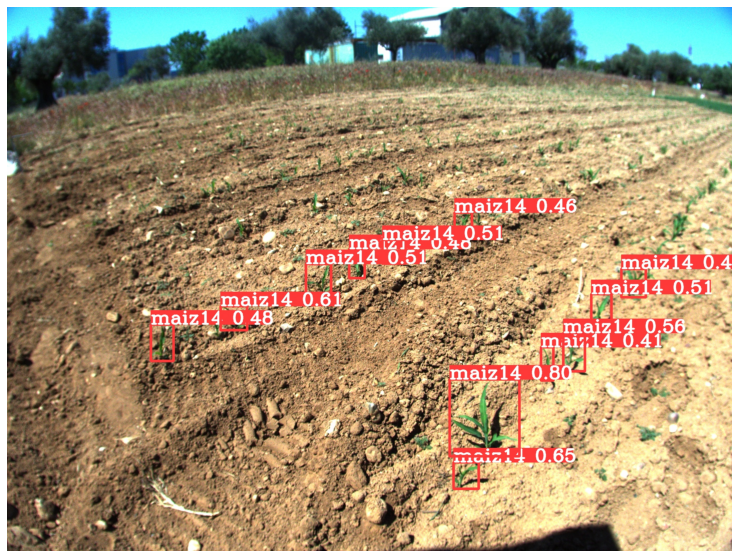

In [40]:
imShow('/content/gdrive/MyDrive/yolov6/runs/val/exp/m13-m14-1410.jpg')